# Analysis into Viability of Opening Bike Shop in Manhattan or DMV Area

### Overview

With this analysis, we seek to identify parameters that will help us identify both a location and market to target with a new bike shop.

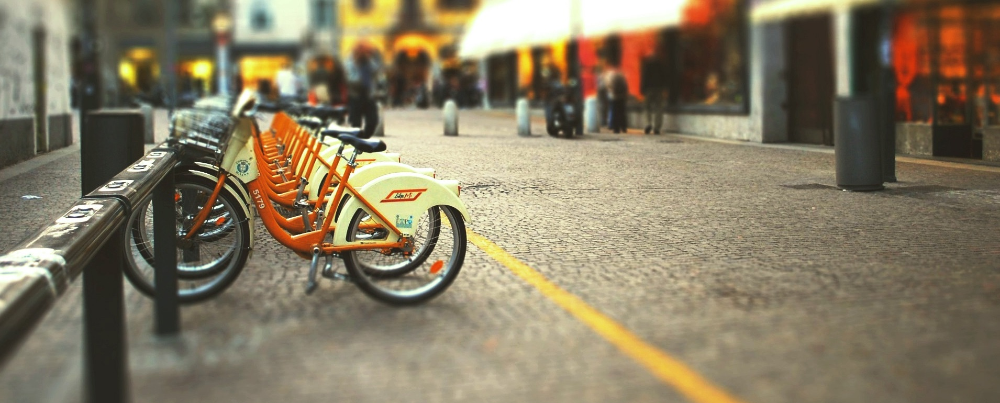

### Business Problem

The goal of the project is to determine an optimal location for bike shops between the Manhattan area in New York City and the DMV (Washington D.C., Maryland, and Virginia areas) as well as which segment of the market to target.

### Data Structure

The datasets that we utilized can be found in the /data folder. All contained findings originate from yelp.

In addition, two geojson files are present in order to overlay bike routes over a map of the areas. The NYC bike route data has been obtained from NYC Open Data while the DMV bike route data has been obtained from Overpass Turbo.

Our data has been parsed and saved into the following datasets:

 - new_york_bike_data.csv
 - washington_data.csv

All visualizations can be found in the /images folder.

### Big Questions

- Where should the business be located?
- Which segment of the market should we focus on?

### Analysis Focus

1. The analysis focused on yelp data pulled for the locations of the NYC and the DC area.
2. Our analysis of this data was primarily focused on price and review counts per location.

### Contributors

[Adam Cumurcu](https://github.com/AdamCumurcu)\
[Isana Mizuma](https://github.com/ismizu)

___

# <center> Data Analysis </center>

___

### Importing Libraries

In [27]:
import json
import folium
import requests
import pandas as pd
import matplotlib.pyplot as plt
from helper_funcs import *

### Pulling Data From Yelp

In [ ]:
#We first import the file containing our API key
with open('../ds-east-042621-lectures/Phase_1/ds-apis-nbz32-main/.secrets/creds.json') as f:
    creds = json.load(f)
#define the terms for the API call 
term = 'bike'
#location would equal 'Washington DC' for DMV data
location = 'Manhattan NY'
SEARCH_LIMIT = 50
url_params = {
        'term': term.replace(' ', '+'),
        'location': location.replace(' ', '+'),
        'limit': SEARCH_LIMIT,
        'offset': 0 
    }

Utilizing the above parameters, we gather and parse the results from Yelp before saving them to a csv file. Yelp limits API calls to return a maximum of fifty businesses per request. Therefore, we pass the functions through a loop that will continue until the appropriate number of businesses are gathered.

In [ ]:
#Create a blank csv file with appropriate columns
pd.DataFrame(columns = ('ID', 'Name', 'Is_Closed', 'Review_Count', 'Rating', 'Price', 
                        'Address1', 'City', 'State', 'Zip_Code', 'Latitude', 'Longitude'))\
                        .to_csv('data/new_york_bike_data.csv', index = False)
                        #.to_csv('data/washington_data.csv') for DMV data

# create a variable  to keep track of which result you are in.
cur = 0
#set up a while loop to go through and grab the result 
while cur < 500:
    
    #set the offset parameter to be where you currently are in the results 
    url_params['offset'] = cur

    results = yelp_call(url_params, creds['key'])
    parsed_results = parse_results(results)
    
    # using a function to insert the parsed results into the db
    # csv filepath would be 'data/washington_data.csv' for DMV data
    df_safe('data/new_york_bike_data.csv', parsed_results)
    
    #increment the counter by 50 to move on to the next results
    cur += 50

### Importing Our Business Data

In [28]:
#Importing our business data
ny_business_df = pd.read_csv('data/new_york_bike_data.csv')
dc_business_df = pd.read_csv('data/washington_data.csv')

In [29]:
#Minor data cleaning to remove unrelated businesses
ny_business_df.drop([405], inplace = True)
dc_business_df.drop([54, 73, 77], inplace = True)

#convert 'Price' from number of dollar signs into integers
ny_business_df['Price'] = ny_business_df\
[ny_business_df['Price'].isna() == False]['Price'].map(lambda x: len(x))

dc_business_df['Price'] = dc_business_df\
[dc_business_df['Price'].isna() == False]['Price'].map(lambda x: len(x))

### Evaluating Our Data

In answering our overarching question of where to open our business and which segment of the market to target, we first evaluate the percentage of bike shops per price point in each respective area.

We convert the price points to a value between one and four, with four being the most expensive. The percentages also factor out Yelp businesses that did not include a value for price.

Text(0.5, 1.0, 'NY vs. DMV Price Point Percentages')

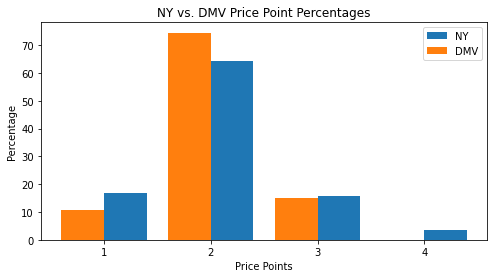

In [30]:
fig, ax = plt.subplots(figsize = (8, 4))

price_points = [1, 2, 3, 4]
#price points are passed through data for each location
#the return percentage is rounded to two decimal points and removes 'Nan' values from consideration
ny_price_percents = [price_percent(ny_business_df, x) for x in price_points]
dc_price_percents = [price_percent(dc_business_df, x) for x in price_points]
w = .4

ax.bar(
    x = price_points,
    height = ny_price_percents,
    align = 'edge',
    width = w
)

ax.bar(
    x = [x - w/2 for x in price_points],
    height = dc_price_percents,
    width = w
)

ax.legend(['NY', 'DMV'])
ax.set_xticks(price_points)
ax.set_xlabel('Price Points')
ax.set_ylabel('Percentage')
ax.set_title('NY vs. DMV Price Point Percentages')

Overall, the percentage of bike shops per price point is relatively similar for both locations. However, there is one notable difference. The DC area does not contain any bike shops within the highest price point. Based on this observation, a high-end bike shop in that area seems more favorable.

To further investigate this initial observation, we view the percentage of reviews that bike shops in both areas currently hold.

Text(0.5, 1.0, 'NY vs. DMV Rating Percentages')

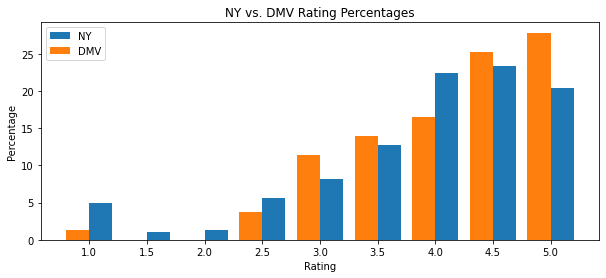

In [31]:
fig, ax = plt.subplots(figsize = (10, 4))

ratings_points = list(set(ny_business_df['Rating'].sort_values()))

#total ratings per each possible rating are returned as percentages for each location
ny_ratings_percents = [ratings_percent(ny_business_df, x) for x in ratings_points]
dc_ratings_percents = [ratings_percent(dc_business_df, x) for x in ratings_points]
w = .2


ax.bar(
    x = ratings_points,
    height = ny_ratings_percents,
    align = 'edge',
    width = w,
)

ax.bar(
    x = [x - w/2 for x in ratings_points],
    height = dc_ratings_percents,
    width = w,
)

ax.set_xticks(ratings_points)
ax.legend(['NY', 'DMV'])
ax.set_xlabel('Rating')
ax.set_ylabel('Percentage')
ax.set_title('NY vs. DMV Rating Percentages')

There are two observations that we observe in the above graph.
1. The DC area's ratings show a steady, upward trend, showing that bike shops are consistently rated at higher levels.
2. The NYC area's ratings are not consistent and shift in an unfavorable pattern. They have a much higher percentage of bike shops with a rating of 1. In addition, the number of bike shops with high ratings begin to cap off at the rating of 4 before decreasing.

This shows us that a higher percentage of bike shops in the DC area are seen favorably when compared to those in the NYC area. This further builds on our hypothesis that the DC area is better for our bike shop.

An additional consideration that we investigated was the availability of bike routes (denoted in blue lines) in the area as well as the location of bike shops along those paths.
First, we view the Manhanttan area.

In [32]:
nyc_map = folium.Map(location = [40.782886, -73.971104], tiles = 'OpenStreetMap', zoom_start = 13)

nyc_coord = list(zip(ny_business_df['Latitude'], ny_business_df['Longitude']))

for coord in nyc_coord:
    folium.Marker(location = coord).add_to(nyc_map)
#geojson contained bike route information
folium.GeoJson('data/nyc_bike_route.geojson').add_to(nyc_map)

nyc_map

From this map, it is clear that the area holds quite extensive bike routes. However, another notable observation is the concentration of bike shops surrounding them. Not only is there an extensive system of bike routes, but a flurry of bike shops along them. This brings into question how well a new bike shop might do, considering the competition it would face.

Seeing this, we now observe the DC area.

In [33]:
dc_map = folium.Map(location = [38.883552, -77.1038692], tiles = 'OpenStreetMap', zoom_start = 11)

dc_coord = list(zip(dc_business_df['Latitude'], dc_business_df['Longitude']))

for coord in dc_coord:
    folium.Marker(location = coord).add_to(dc_map)
#geojson contained bike route information
folium.GeoJson('data/dc_bike_route.geojson').add_to(dc_map)

dc_map

In a similar vein, the DC area contains an extensive network of bike routes. However, one notable difference is the lower concentration of bike shops. Compared to our mapping of the NYC area, DC contains a considerably lower availability of bike shops.

___

# <center> Final Analysis </center>

___

Thus far, the DC area shows more favorable results based on our analysis of the average ratings, available price points, and concentration of current shops.
However, in choosing to target the high-end market, we also observe the relation between price and ratings.

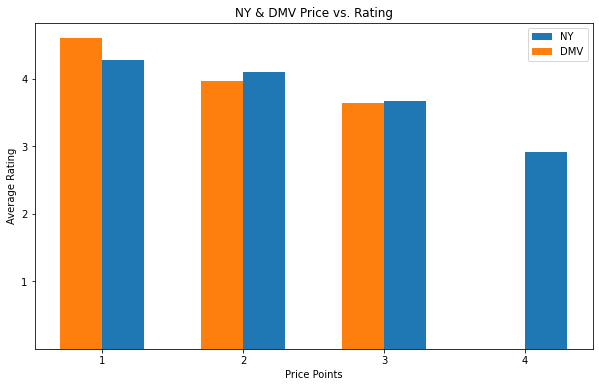

In [34]:
fig, ax = plt.subplots(figsize = (10, 6))

price_axis_ny = [1, 2, 3, 4]
price_axis_dc = [1, 2, 3]
w = .3

ny_data = list(pd.DataFrame(ny_business_df.groupby('Price').mean()['Rating'])['Rating'])
dc_data = list(pd.DataFrame(dc_business_df.groupby('Price').mean()['Rating'])['Rating'])

ax.bar(
    x = price_axis_ny,
    height = ny_data,
    align = 'edge',
    width = w,
)
ax.bar(
    x = [x - w/2 for x in price_axis_dc],
    height = dc_data,
    width = w,
)

ax.set_xticks([1,2,3,4])
ax.set_yticks([1,2,3,4])
ax.legend(['NY', 'DMV'])
ax.set_xlabel('Price Points')
ax.set_ylabel('Average Rating')
ax.set_title('NY & DMV Price vs. Rating')
fig.savefig('price_vs_rating')

Here, we observe a negative trend between the price point and average rating. As the price point increases, the average review falls.

Without data on bike shops in DC with a price level of four, we can only assume that the DMV will continue this trend. We hypothesize that the reason for this trend is that wealthier customers tend to be more discerning and therefore demand a higher quality experience. However, we cannot make any concrete conclusions due to a lack of available data. What is notable is the trend's consistency between the available NY and DMV data. As such, with all other results pointing in the direction of the DC high-end market, we choose to target this market.